In [1]:
from nipype.interfaces.semtools.registration import brainsfit as bf
from nipype.pipeline.engine import Node, Workflow
import os
import ants
from glob import glob

# Find the paths

## Find a 300x300x300 template for each subject image that are used during the manual linear registration. There were 3 template images used and most of the subject images should be matching with them. Also find their transform files and the images in original 25 micron subject space generated after NIS.

In [2]:
subject_template_origin = {}

In [3]:
subject_template_origin['Templates'] = {}

In [4]:
subject_template_origin['Templates']['Template1'] = {}
subject_template_origin['Templates']['Template2'] = {}
subject_template_origin['Templates']['Template3'] = {}

In [5]:
# Templates used in manual registration.
subject_template_origin['Templates']['Template1']['Path'] = "/lichtman/mdere/Felix/MOUSE/LS_P4Registered/LS/LS_MR13_Template/L35D719P4_C1_topro_25_300x300x300.nrrd"
subject_template_origin['Templates']['Template2']['Path'] = "/lichtman/mdere/Felix/MOUSE/LS_P4Registered/LS/pair14/L35D719P4_C1_topro_25_300x300x300_1.nrrd"
subject_template_origin['Templates']['Template3']['Path'] = "/lichtman/mdere/Felix/MOUSE/LS_P4Registered/LS/Remaining_02_27_2023/pair6/L35D719P4_C1_topro_25_300x300x300.nrrd"

In [6]:
# The origins are important because after registration the registered images origin is matching with the template images origin. 
# This helps us to find/backtrack which template was used with which image.
for template in subject_template_origin['Templates'].keys():
    subject_template_origin['Templates'][template]['Origin'] = ants.image_read(subject_template_origin['Templates'][template]['Path']).origin

In [7]:
subject_template_origin['RotCorrectedSubjects'] = {}

In [22]:
#Find manually registred images of subject so that we can find and match their origins with the templates.
for each in glob("/lichtman/mdere/Felix/P4AllenAverageToLightSheet/LinearAndLandmark/Out/ANTsLinear10272023/Affine/*/*_masked.nii.gz"):
    sid = os.path.basename(each).split("_")[0]
    subject_template_origin['RotCorrectedSubjects'][sid] = {}
    subject_template_origin['RotCorrectedSubjects'][sid]['Path'] = each
    subject_template_origin['RotCorrectedSubjects'][sid]['TransformPath'] = ""
    subject_template_origin['RotCorrectedSubjects'][sid]['Origin'] = ants.image_read(each).origin
    
    subject_template_origin['RotCorrectedSubjects'][sid]['Template'] = None
    for template in subject_template_origin['Templates'].keys():
        if subject_template_origin['RotCorrectedSubjects'][sid]['Origin'] == subject_template_origin['Templates'][template]['Origin']:
            subject_template_origin['RotCorrectedSubjects'][sid]['Template'] = subject_template_origin['Templates'][template]['Path']
            print(sid, ' has a template', template)
            break
    if subject_template_origin['RotCorrectedSubjects'][sid]['Template'] == None:
        subject_template_origin['RotCorrectedSubjects'][sid]['Template'] = '/lichtman/mdere/Felix/MOUSE/LS_P4Registered/LS/pair5/L35D719P4_C1_topro_25_300x300x300.nrrd'
        print('Image is using itself as a template')
        #print(sid, ' has no template matching. Check the Rotation corrected image origins to see if a LS image was used as a temlate for this subject.')

L66D764P6  has a template Template2
L79D769P5  has a template Template1
L79D769P7  has a template Template1
L79D769P8  has a template Template1
L59D878P1  has a template Template1
L59D878P5  has a template Template2
L91D814P2  has a template Template1
L64D804P3  has a template Template2
L57D855P2  has a template Template3
L64D804P9  has a template Template2
L35D719P4  has a template Template1
L66D764P8  has a template Template2
Image is using itself as a template
Image is using itself as a template
L66D764P3  has a template Template2
L73D766P7  has a template Template2
L73D766P9  has a template Template2
L66D764P5  has a template Template2
L73D766P5  has a template Template2
L91D814P4  has a template Template1
L79D769P9  has a template Template1
L74D769P4  has a template Template2
L74D769P8  has a template Template2
L73D766P4  has a template Template2
L91D814P3  has a template Template1
L91D814P6  has a template Template1
L64D804P6  has a template Template2
L64D804P4  has a template Te

## As we can see above many of the images are matching with the templates. The ones don't match are the initial one and one another subject image (L57D855P5). FOr L57D855P5 I possibly used a subject image (with a size 300x300x300) as a template.

# Test NiPype use here with an example subject.

In [9]:
subject_template_origin['RotCorrectedSubjects']['L66D764P6']['Path']

'/lichtman/mdere/Felix/P4AllenAverageToLightSheet/LinearAndLandmark/Out/ANTsLinear10272023/Affine/L66D764P6/L66D764P6_masked.nii.gz'

In [10]:
# Define input file paths
fixed_image_path = '/lichtman/mdere/Felix/MOUSE/LS_P4Registered/LS/pair14/L35D719P4_C1_topro_25_300x300x300_1.nrrd'  # Replace with the path to your fixed image
moving_image_path = '/lichtman/Felix/Lightsheet/P4/pair8/output_L59D878P5/resampled/L59D878P5_C1_topro_25.nii'  # Replace with the path to your moving image
initial_transform_path = '/lichtman/mdere/Felix/MOUSE/LS_P4Registered/LS/pair8/L59D878P5_ManualTransform.mat'  # Replace with your transform file

In [13]:
# Create a BRAINSFit node
brains_fit = Node(bf.BRAINSFit(), name='brains_fit')

# Set the fixed and moving images
brains_fit.inputs.fixedVolume = fixed_image_path
brains_fit.inputs.movingVolume = moving_image_path

# Set the initial transformation
brains_fit.inputs.initialTransform = initial_transform_path

# Specify the transformation type
brains_fit.inputs.transformType = 'Rigid'

# Set the number of iterations to zero
brains_fit.inputs.numberOfIterations = [0]

# Set interpolation to nearest neighbor
brains_fit.inputs.interpolationMode = 'NearestNeighbor'

# Additional parameters
brains_fit.inputs.outputTransform = 'output_transform.h5'
brains_fit.inputs.outputVolume = 'output_warped_image.nii'

# Create a workflow
wf = Workflow(name='brainsfit_workflow')
wf.base_dir = os.path.abspath('brainsfit_workflow_dir')  # Directory where workflow files will be stored

# Add the BRAINSFit node to the workflow
wf.add_nodes([brains_fit])

# Run the workflow
wf.run()

231218-17:36:22,139 nipype.workflow INFO:
	 Workflow brainsfit_workflow settings: ['check', 'execution', 'logging', 'monitoring']
231218-17:36:22,174 nipype.workflow INFO:
	 Running serially.
231218-17:36:22,175 nipype.workflow INFO:
	 [Node] Setting-up "brainsfit_workflow.brains_fit" in "/lichtman/mdere/Felix/P4AllenAverageToLightSheet/LinearAndLandmark/Code/brainsfit_workflow_dir/brainsfit_workflow/brains_fit".
231218-17:36:22,186 nipype.workflow INFO:
	 [Node] Executing "brains_fit" <nipype.interfaces.semtools.registration.brainsfit.BRAINSFit>
231218-17:36:22,595 nipype.interface INFO:
	 stdout 2023-12-18T17:36:22.594931:Original Fixed image origin[-15, -90, 30, 0]
231218-17:36:22,648 nipype.interface INFO:
	 stdout 2023-12-18T17:36:22.647953:Read ITK transform from file: /lichtman/mdere/Felix/MOUSE/LS_P4Registered/LS/pair8/L59D878P5_ManualTransform.mat
231218-17:36:22,650 nipype.interface INFO:
	 stdout 2023-12-18T17:36:22.650193:HACK: 0  AffineTransform
231218-17:36:22,650 nipype.

# Now doing the actual work. Find the images that are located in Cajal because those are the ones that were not available during the manual transforms. So there is no need for this on those subjects. Those are the ones that are registered without rotation correction.

In [23]:
#Manually add the cajal subjects here
cajal_list = ['L77D764P9',
'L77D764P8',
'L77D764P2',
'L77D764P4',
'L57D855P6',
'L57D855P4']

In [24]:
sid

'L64D804P4'

In [25]:
glob(f"/cajal/ACMUSERS/ziquanw/Lightsheet/renders/pair*/NIS_density_pair*_{sid}.nii")

['/cajal/ACMUSERS/ziquanw/Lightsheet/renders/pair9/NIS_density_pair9_L64D804P4.nii']

In [26]:
# Run registration of BRAINSFit through NiPype. There are subjects those don't need registration, pass registration and fails with different reasons. We have a counter for each of those.
no_need_ctr = 0
no_density_ctr = 0
no_transform_ctr = 0
registered_ctr = 0
failed_ctr = 0
for sid in subject_template_origin['RotCorrectedSubjects'].keys():

    if not os.path.isfile(f'/lichtman/mdere/Felix/P4AllenAverageToLightSheet/LinearAndLandmark/Code/RegisteredDensityJan162024/{sid}/brainsfit_workflow/brains_fit/output_warped_image.nii'):
        print(f"------------- WORKING ON {sid} ---------------------")
        # Define input file paths
        fixed_image_path = subject_template_origin['RotCorrectedSubjects'][sid]['Template']  # Replace with the path to your fixed image
        
        # Check if this subject came after the ManualTransform work. If yes then there is no need for this. 
        # We get the Landmark transform directly on the subject space without rotation correction.
        if sid in cajal_list:
            print(f"------------- NO TRANSFORM NEEDED {sid} ---------------------")
            no_need_ctr+=1
            subject_template_origin['RotCorrectedSubjects'][sid]['TransformPath'] = "cajal"
            continue
            
        #Try to find a transform
        initial_transform_path = ''
        if len(glob(f"/lichtman/mdere/Felix/MOUSE/LS_P4Registered/LS/Remaining_12_22_2022/pair*/LS/{sid}*anualTransform.mat")) > 0:
            initial_transform_path = glob(f"/lichtman/mdere/Felix/MOUSE/LS_P4Registered/LS/Remaining_12_22_2022/pair*/LS/{sid}*anualTransform.mat")[0]
        
        elif len(glob(f"/lichtman/mdere/Felix/MOUSE/LS_P4Registered/LS/Remaining_02_27_2023/pair*/LS/{sid}*anualTransform.mat")) > 0:
            initial_transform_path = glob(f"/lichtman/mdere/Felix/MOUSE/LS_P4Registered/LS/Remaining_02_27_2023/pair*/LS/{sid}*anualTransform.mat")[0]
        
        elif len(glob(f"/lichtman/mdere/Felix/MOUSE/LS_P4Registered/LS/pair*/{sid}.mat")) > 0:
            initial_transform_path = glob(f"/lichtman/mdere/Felix/MOUSE/LS_P4Registered/LS/pair*/{sid}.mat")[0]
            
        elif len(glob(f"/lichtman/mdere/Felix/MOUSE/LS_P4Registered/LS/pair*/{sid}*anualTransform.mat")) > 0:
            initial_transform_path = glob(f"/lichtman/mdere/Felix/MOUSE/LS_P4Registered/LS/pair*/{sid}*anualTransform.mat")[0]

        else:
            print(sid, "------------- NO TRANSFORM FOUND ! ---------------------")
            no_transform_ctr+=1
            continue
        subject_template_origin['RotCorrectedSubjects'][sid]['TransformPath'] = initial_transform_path
        
        # Try to find a NIS Density map
        if len(glob(f"/cajal/ACMUSERS/ziquanw/Lightsheet/renders/pair*/NIS_density_pair*_{sid}.nii")) != 1:
            print(sid, "------------- NO NIS DENSITY IMAGE FOUND ! ---------------------")
            no_density_ctr+=1
            continue
        
        # Register if a template is found.
        elif fixed_image_path != None:
            moving_image_path = glob(f"/cajal/ACMUSERS/ziquanw/Lightsheet/renders/pair*/NIS_density_pair*_{sid}.nii")[0] # Replace with the path to your moving image
            
            print("Registering ", sid)
            # Create a BRAINSFit node
            brains_fit = Node(bf.BRAINSFit(), name='brains_fit')

            # Set the fixed and moving images
            brains_fit.inputs.fixedVolume = fixed_image_path
            brains_fit.inputs.movingVolume = moving_image_path

            # Set the initial transformation
            brains_fit.inputs.initialTransform = initial_transform_path

            # Specify the transformation type
            brains_fit.inputs.transformType = 'Rigid'

            # Set the number of iterations to zero
            brains_fit.inputs.numberOfIterations = [0]

            # Set interpolation to nearest neighbor
            brains_fit.inputs.interpolationMode = 'NearestNeighbor'

            # Additional parameters
            brains_fit.inputs.outputTransform = 'output_transform.h5'
            brains_fit.inputs.outputVolume = 'output_warped_image.nii'

            # Create a workflow
            wf = Workflow(name='brainsfit_workflow')
            wf.base_dir = os.path.abspath(f'/lichtman/mdere/Felix/P4AllenAverageToLightSheet/LinearAndLandmark/Code/RegisteredDensityJan162024/{sid}')  # Directory where workflow files will be stored

            # Add the BRAINSFit node to the workflow
            wf.add_nodes([brains_fit])

            # Run the workflow
            wf.run()
            
            registered_ctr+=1
        else:
            print(sid, "---------------------------Failed to register -----------------------------")
            failed_ctr+=1
            # fixed_image_path = f'/lichtman/mdere/Felix/P4AllenAverageToLightSheet/LinearAndLandmark/Out/Landmark/ACMInitialWork/{sid}/{sid}_masked.nii.gz'
            # moving_image_path = glob(f"/cajal/ACMUSERS/ziquanw/Lightsheet/renders/pair*/NIS_density_pair*_{sid}.nii")[0] # Replace with the path to your moving image
            
            # print("Registering ", sid)
            # # Create a BRAINSFit node
            # brains_fit = Node(bf.BRAINSFit(), name='brains_fit')

            # # Set the fixed and moving images
            # brains_fit.inputs.fixedVolume = fixed_image_path
            # brains_fit.inputs.movingVolume = moving_image_path

            # # Set the initial transformation
            # brains_fit.inputs.initialTransform = initial_transform_path

            # # Specify the transformation type
            # brains_fit.inputs.transformType = 'Rigid'

            # # Set the number of iterations to zero
            # brains_fit.inputs.numberOfIterations = [0]

            # # Set interpolation to nearest neighbor
            # brains_fit.inputs.interpolationMode = 'NearestNeighbor'

            # # Additional parameters
            # brains_fit.inputs.outputTransform = 'output_transform.h5'
            # brains_fit.inputs.outputVolume = 'output_warped_image.nii'

            # # Create a workflow
            # wf = Workflow(name='brainsfit_workflow')
            # wf.base_dir = os.path.abspath(f'/lichtman/mdere/Felix/P4AllenAverageToLightSheet/LinearAndLandmark/Code/RegisteredDensityJan162024/{sid}')  # Directory where workflow files will be stored

            # # Add the BRAINSFit node to the workflow
            # wf.add_nodes([brains_fit])

            # # Run the workflow
            # wf.run()
            
            # registered_ctr+=1
            
print(no_need_ctr,
no_density_ctr,
no_transform_ctr,
registered_ctr,
failed_ctr)

------------- WORKING ON L59D878P1 ---------------------
L59D878P1 ------------- NO NIS DENSITY IMAGE FOUND ! ---------------------
------------- WORKING ON L35D719P1 ---------------------
Registering  L35D719P1
240227-18:54:19,197 nipype.workflow INFO:
	 Workflow brainsfit_workflow settings: ['check', 'execution', 'logging', 'monitoring']
240227-18:54:19,212 nipype.workflow INFO:
	 Running serially.
240227-18:54:19,213 nipype.workflow INFO:
	 [Node] Setting-up "brainsfit_workflow.brains_fit" in "/lichtman/mdere/Felix/P4AllenAverageToLightSheet/LinearAndLandmark/Code/RegisteredDensityJan162024/L35D719P1/brainsfit_workflow/brains_fit".
240227-18:54:19,240 nipype.workflow INFO:
	 [Node] Executing "brains_fit" <nipype.interfaces.semtools.registration.brainsfit.BRAINSFit>


240227-18:54:19,655 nipype.interface INFO:
	 stdout 2024-02-27T18:54:19.655349:Original Fixed image origin[-70, -30, 30, 0]
240227-18:54:19,758 nipype.interface INFO:
	 stdout 2024-02-27T18:54:19.758142:Read ITK transform from file: /lichtman/mdere/Felix/MOUSE/LS_P4Registered/LS/pair3/L35D719P1_ManualTransform.mat
240227-18:54:19,760 nipype.interface INFO:
	 stdout 2024-02-27T18:54:19.760436:HACK: 0  AffineTransform
240227-18:54:19,761 nipype.interface INFO:
	 stdout 2024-02-27T18:54:19.761829:TransformTypes: Rigid(1 of 1).
240227-18:54:19,763 nipype.interface INFO:
	 stdout 2024-02-27T18:54:19.761829:
240227-18:54:19,764 nipype.interface INFO:
	 stdout 2024-02-27T18:54:19.761829:
240227-18:54:19,764 nipype.interface INFO:
	 stdout 2024-02-27T18:54:19.761829:
240227-18:54:19,765 nipype.interface INFO:
	 stdout 2024-02-27T18:54:19.761829:
240227-18:54:19,766 nipype.interface INFO:
	 stdout 2024-02-27T18:54:19.761829:=============================== ITKv4 Registration: Starting Transform 

L66D764P6


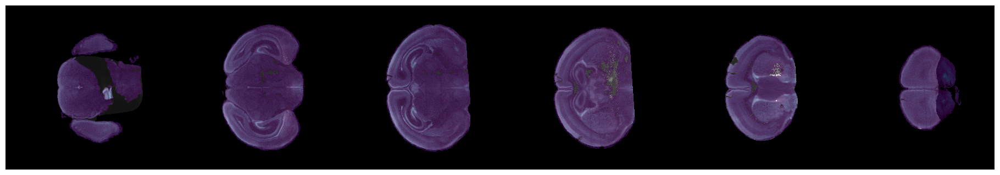

L79D769P5


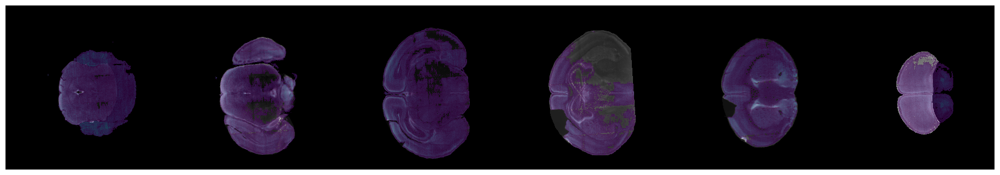

L79D769P7


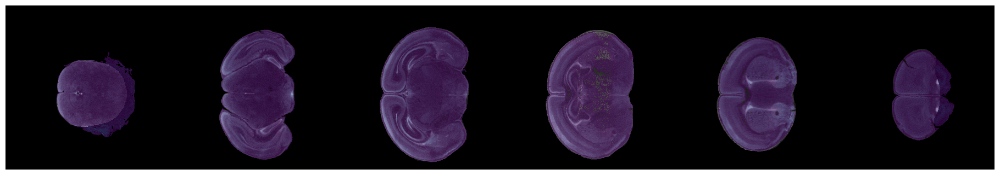

L79D769P8


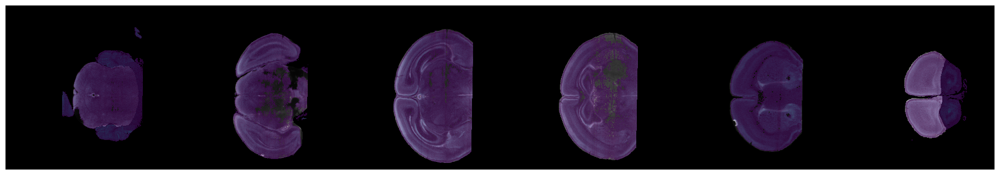

L59D878P1
L59D878P5


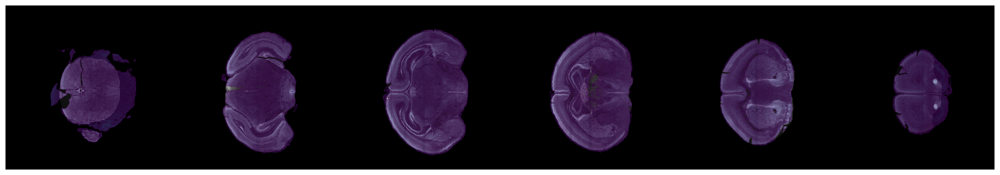

L91D814P2


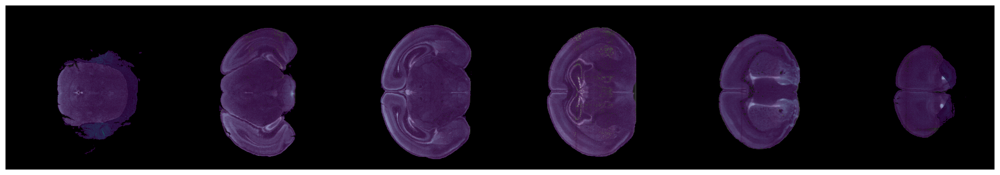

L64D804P3


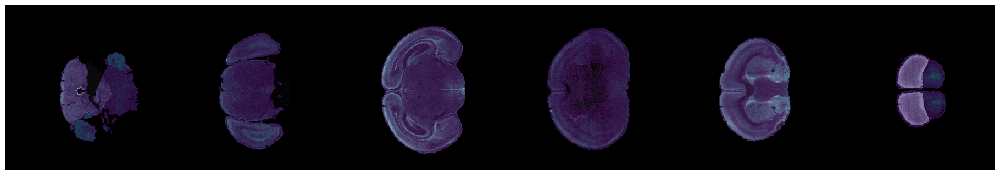

L57D855P2


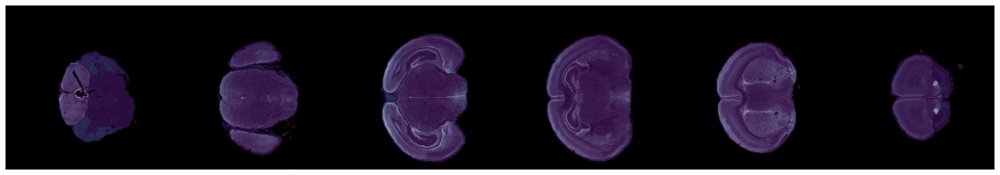

L64D804P9


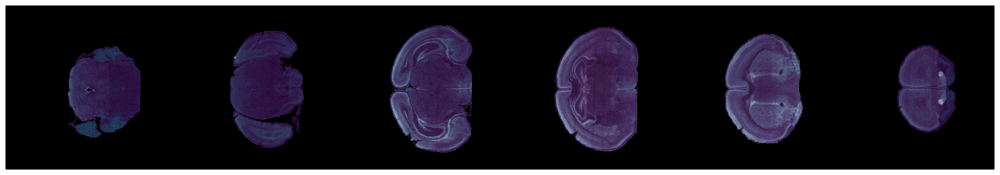

L35D719P4


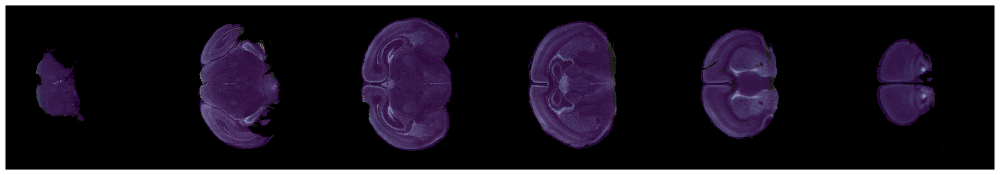

L66D764P8


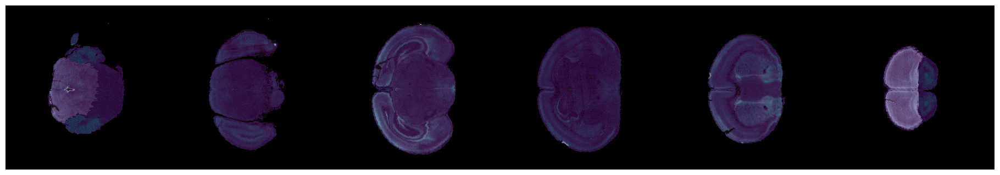

L35D719P1


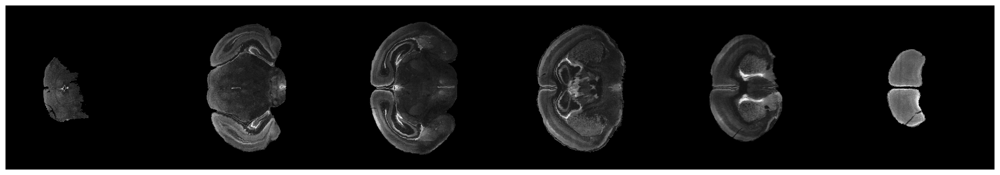

L57D855P5


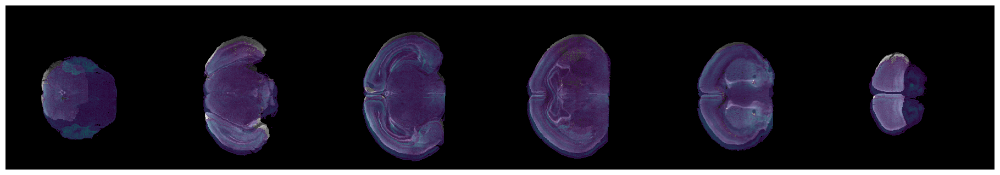

L66D764P3


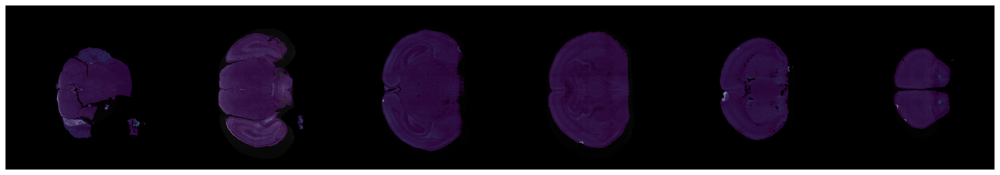

L73D766P7


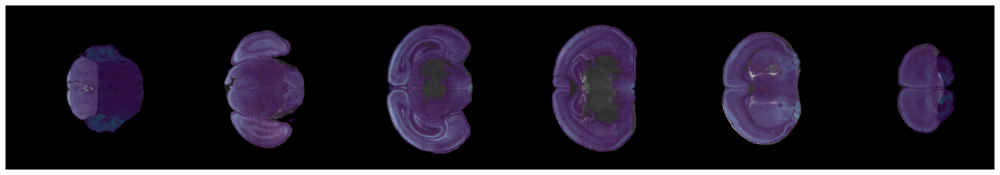

L73D766P9


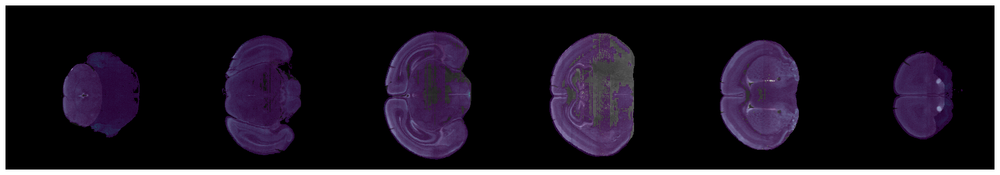

L66D764P5


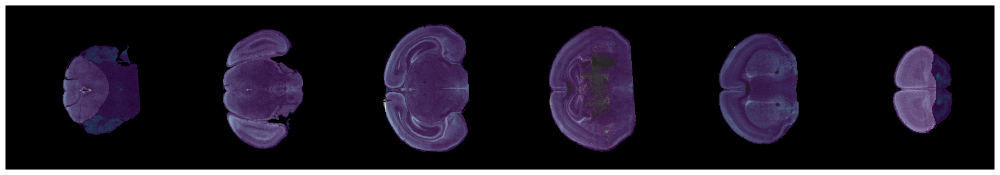

L73D766P5


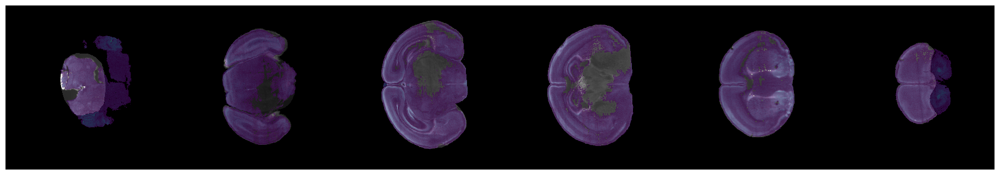

L91D814P4


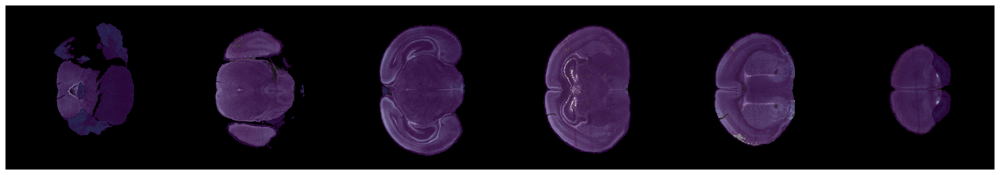

L79D769P9


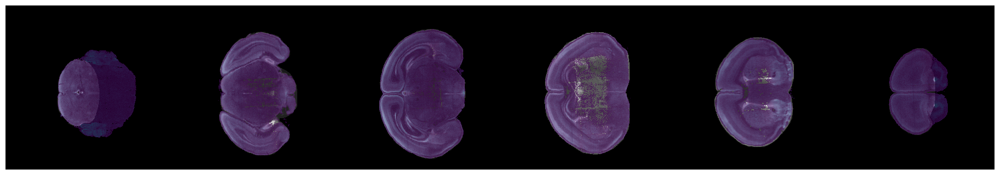

L74D769P4


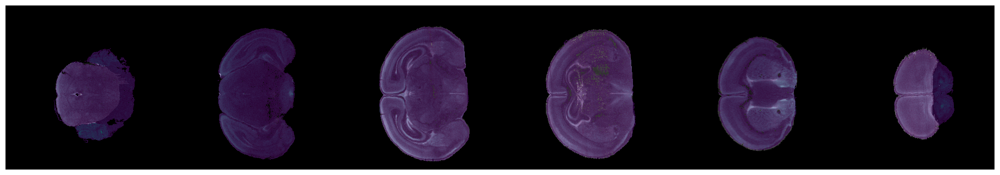

L74D769P8


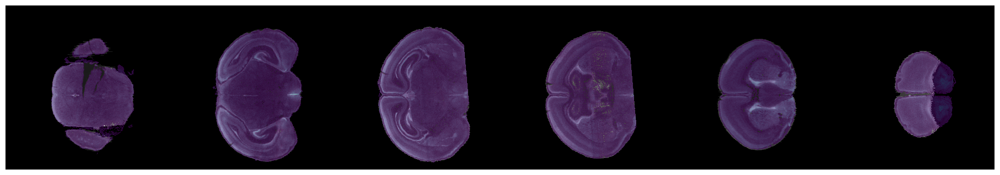

L73D766P4


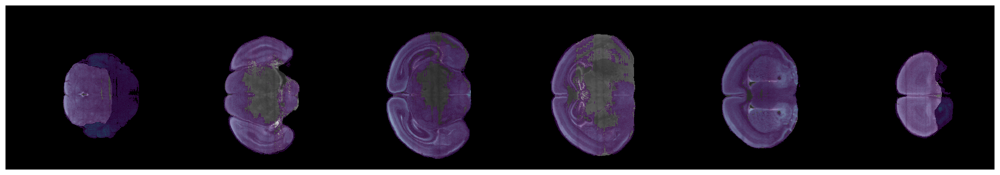

L91D814P3


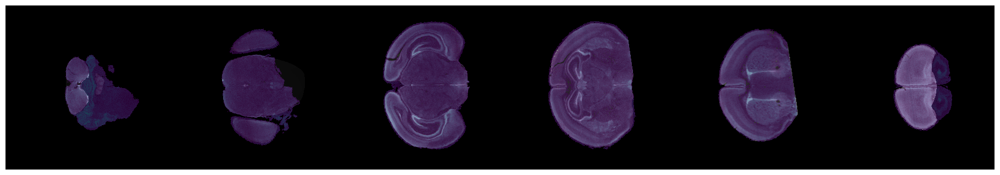

L91D814P6


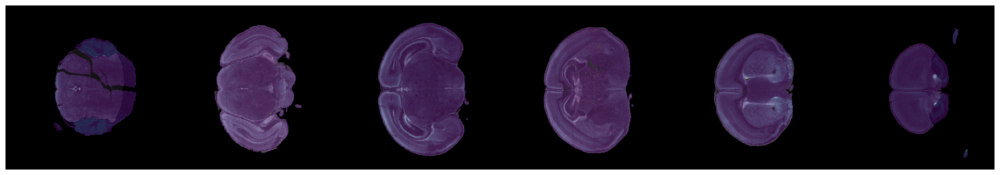

L64D804P6


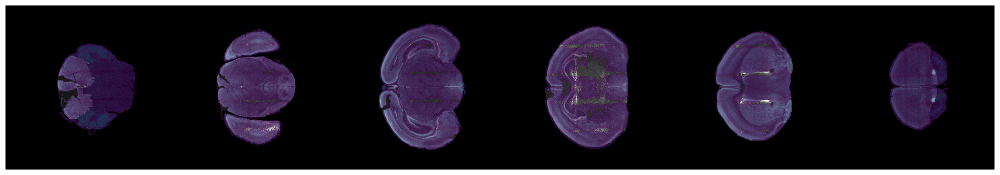

L64D804P4


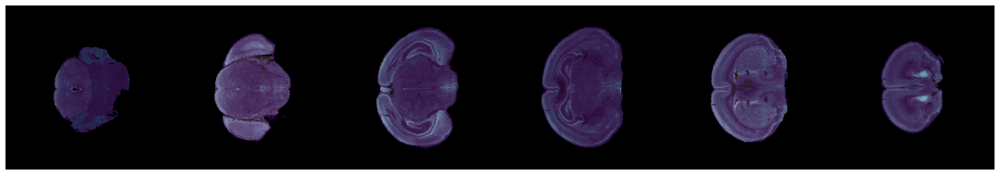

In [27]:
for sid in subject_template_origin['RotCorrectedSubjects'].keys():
    print(sid)
    density_registered_path = f'/lichtman/mdere/Felix/P4AllenAverageToLightSheet/LinearAndLandmark/Code/RegisteredDensityJan162024/{sid}/brainsfit_workflow/brains_fit/output_warped_image.nii'
    if subject_template_origin['RotCorrectedSubjects'][sid]['Template'] != None and os.path.isfile(density_registered_path):
        ls_masked_ants = ants.image_read(subject_template_origin['RotCorrectedSubjects'][sid]['Path'])
        density_registered_ants  = ants.image_read(density_registered_path)
        density_registered_ants.set_spacing(ls_masked_ants.spacing)
        ants.plot(ls_masked_ants, overlay = density_registered_ants, overlay_cmap = 'viridis', overlay_alpha=0.6, figsize=3, nslices=6)

In [29]:
# Run registration of BRAINSFit through NiPype. There are subjects those don't need registration, pass registration and fails with different reasons. We have a counter for each of those.
no_need_ctr = 0
no_density_ctr = 0
no_transform_ctr = 0
registered_ctr = 0
failed_ctr = 0
for sid in subject_template_origin['RotCorrectedSubjects'].keys():
    if not os.path.isfile(f'/lichtman/mdere/Felix/P4AllenAverageToLightSheet/LinearAndLandmark/Code/RegisteredVolAvgJan162024/{sid}/brainsfit_workflow/brains_fit/output_warped_image.nii'):
        print(f"------------- WORKING ON {sid} ---------------------")
        # Define input file paths
        fixed_image_path = subject_template_origin['RotCorrectedSubjects'][sid]['Template']  # Replace with the path to your fixed image
        
        # Check if this subject came after the ManualTransform work. If yes then there is no need for this. 
        # We get the Landmark transform directly on the subject space without rotation correction.
        if sid in cajal_list:
            print(f"------------- NO TRANSFORM NEEDED {sid} ---------------------")
            no_need_ctr+=1
            subject_template_origin['RotCorrectedSubjects'][sid]['TransformPath'] = "cajal"
            continue
            
        #Try to find a transform
        initial_transform_path = ''
        if len(glob(f"/lichtman/mdere/Felix/MOUSE/LS_P4Registered/LS/Remaining_12_22_2022/pair*/LS/{sid}*anualTransform.mat")) > 0:
            initial_transform_path = glob(f"/lichtman/mdere/Felix/MOUSE/LS_P4Registered/LS/Remaining_12_22_2022/pair*/LS/{sid}*anualTransform.mat")[0]
        
        elif len(glob(f"/lichtman/mdere/Felix/MOUSE/LS_P4Registered/LS/Remaining_02_27_2023/pair*/LS/{sid}*anualTransform.mat")) > 0:
            initial_transform_path = glob(f"/lichtman/mdere/Felix/MOUSE/LS_P4Registered/LS/Remaining_02_27_2023/pair*/LS/{sid}*anualTransform.mat")[0]
        
        elif len(glob(f"/lichtman/mdere/Felix/MOUSE/LS_P4Registered/LS/pair*/{sid}.mat")) > 0:
            initial_transform_path = glob(f"/lichtman/mdere/Felix/MOUSE/LS_P4Registered/LS/pair*/{sid}.mat")[0]
            
        elif len(glob(f"/lichtman/mdere/Felix/MOUSE/LS_P4Registered/LS/pair*/{sid}*anualTransform.mat")) > 0:
            initial_transform_path = glob(f"/lichtman/mdere/Felix/MOUSE/LS_P4Registered/LS/pair*/{sid}*anualTransform.mat")[0]

        else:
            print(sid, "------------- NO TRANSFORM FOUND ! ---------------------")
            no_transform_ctr+=1
            continue
        subject_template_origin['RotCorrectedSubjects'][sid]['TransformPath'] = initial_transform_path
        
        # Try to find a NIS Density map
        if len(glob(f"/cajal/ACMUSERS/ziquanw/Lightsheet/renders/pair*/NIS_volavg_pair*_{sid}.nii")) != 1:
            print(sid, "------------- NO NIS DENSITY IMAGE FOUND ! ---------------------")
            no_density_ctr+=1
            continue
        
        # Register if a template is found.
        elif fixed_image_path != None:
            moving_image_path = glob(f"/cajal/ACMUSERS/ziquanw/Lightsheet/renders/pair*/NIS_volavg_pair*_{sid}.nii")[0] # Replace with the path to your moving image
            
            print("Registering ", sid)
            # Create a BRAINSFit node
            brains_fit = Node(bf.BRAINSFit(), name='brains_fit')

            # Set the fixed and moving images
            brains_fit.inputs.fixedVolume = fixed_image_path
            brains_fit.inputs.movingVolume = moving_image_path

            # Set the initial transformation
            brains_fit.inputs.initialTransform = initial_transform_path

            # Specify the transformation type
            brains_fit.inputs.transformType = 'Rigid'

            # Set the number of iterations to zero
            brains_fit.inputs.numberOfIterations = [0]

            # Set interpolation to nearest neighbor
            brains_fit.inputs.interpolationMode = 'NearestNeighbor'

            # Additional parameters
            brains_fit.inputs.outputTransform = 'output_transform.h5'
            brains_fit.inputs.outputVolume = 'output_warped_image.nii'

            # Create a workflow
            wf = Workflow(name='brainsfit_workflow')
            wf.base_dir = os.path.abspath(f'/lichtman/mdere/Felix/P4AllenAverageToLightSheet/LinearAndLandmark/Code/RegisteredVolAvgJan162024/{sid}')  # Directory where workflow files will be stored

            # Add the BRAINSFit node to the workflow
            wf.add_nodes([brains_fit])

            # Run the workflow
            wf.run()
            
            registered_ctr+=1
        else:
            print(sid, "---------------------------Failed to register -----------------------------")
            failed_ctr+=1
        
print(no_need_ctr,
no_density_ctr,
no_transform_ctr,
registered_ctr,
failed_ctr)

------------- WORKING ON L59D878P1 ---------------------
L59D878P1 ------------- NO NIS DENSITY IMAGE FOUND ! ---------------------
0 1 0 0 0


L66D764P6


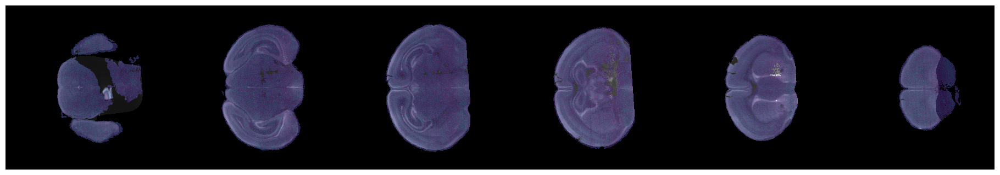

L79D769P5


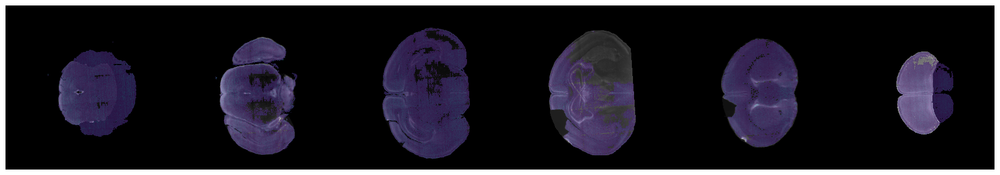

L79D769P7


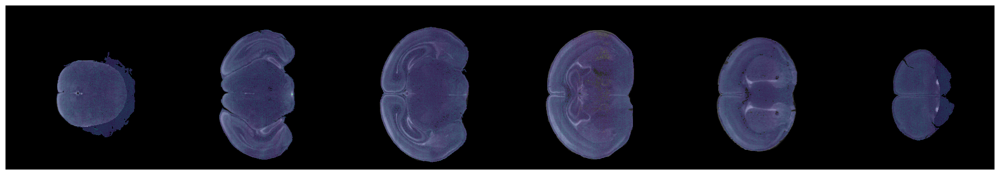

L79D769P8


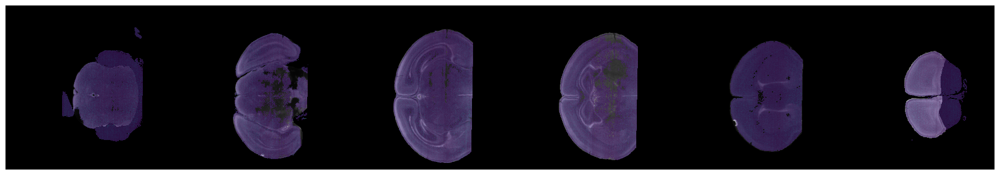

L59D878P1
L59D878P5


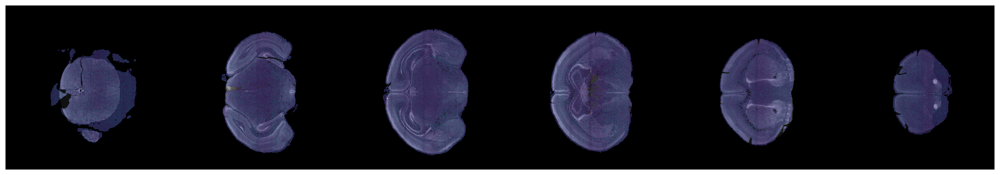

L91D814P2


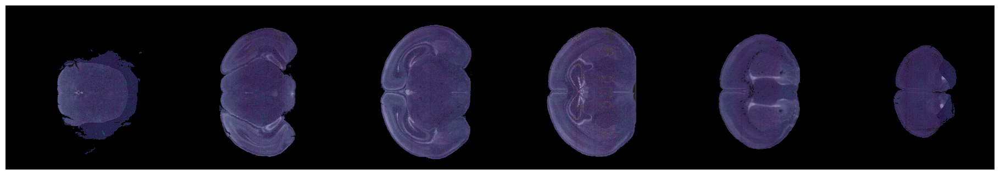

L64D804P3


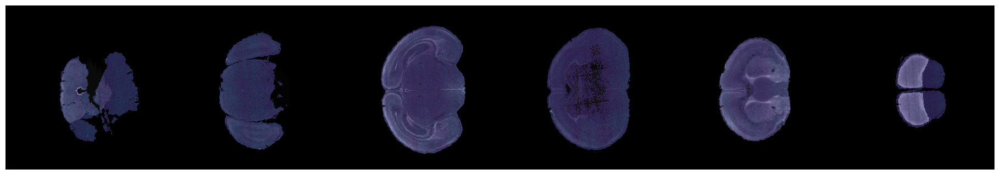

L57D855P2


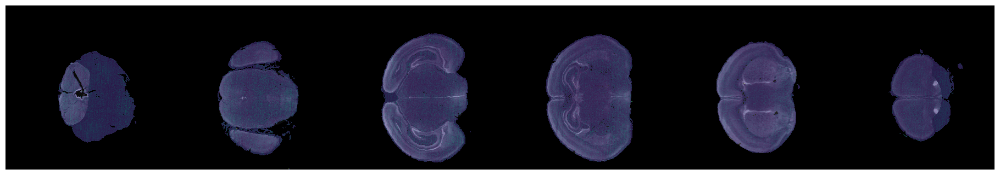

L64D804P9


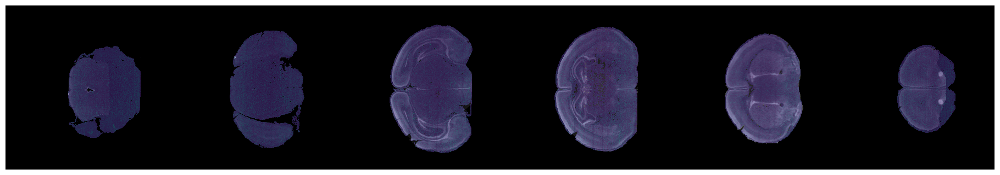

L35D719P4


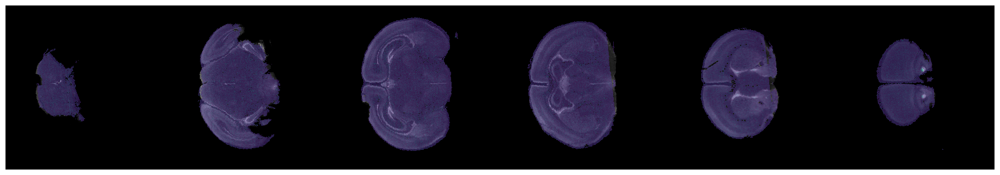

L66D764P8


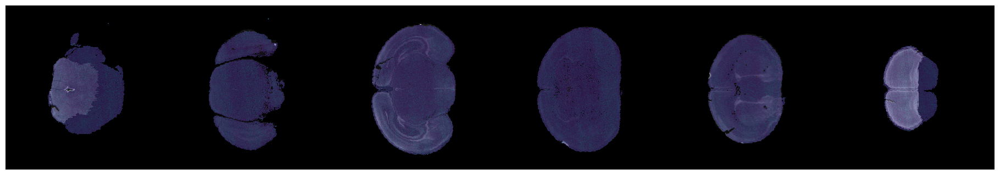

L35D719P1


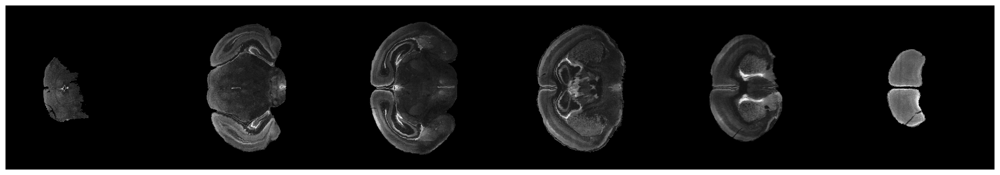

L57D855P5


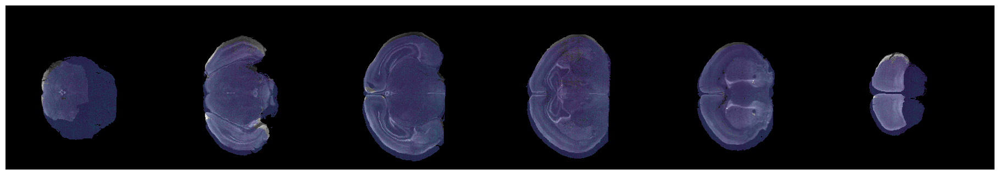

L66D764P3


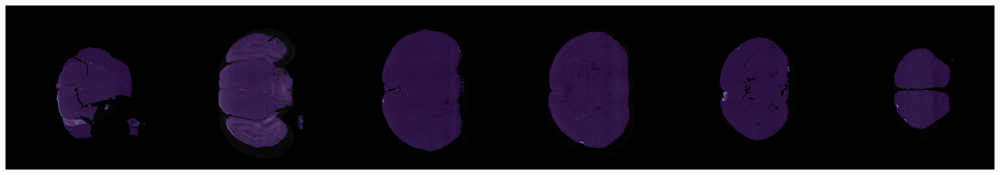

L73D766P7


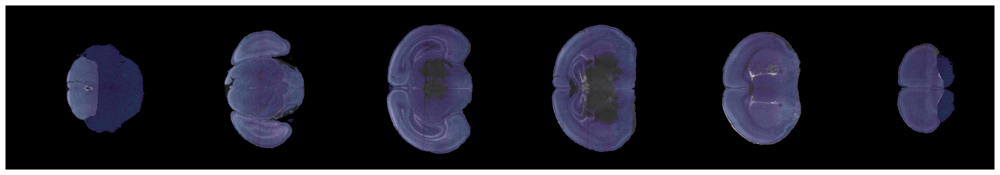

L73D766P9


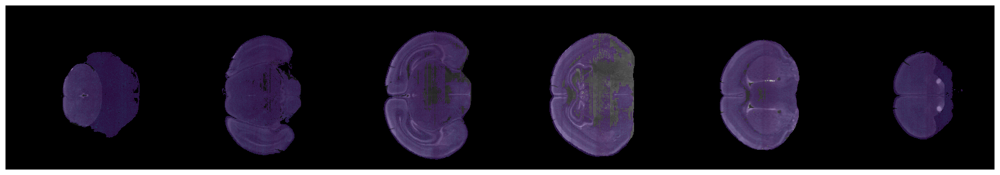

L66D764P5


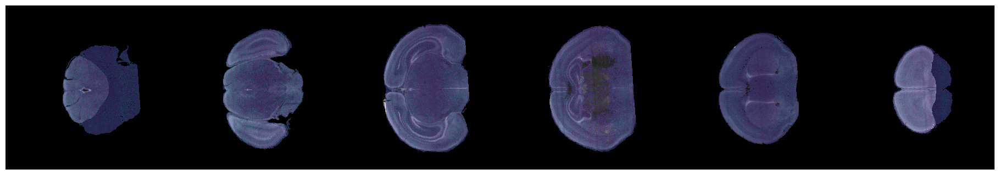

L73D766P5


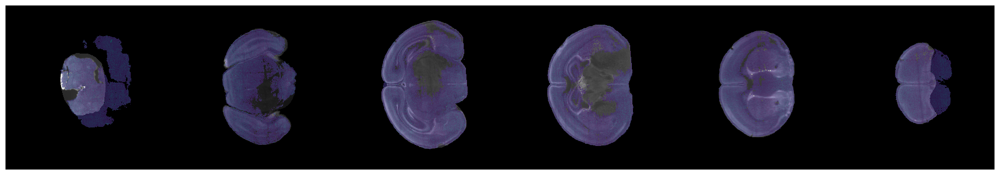

L91D814P4


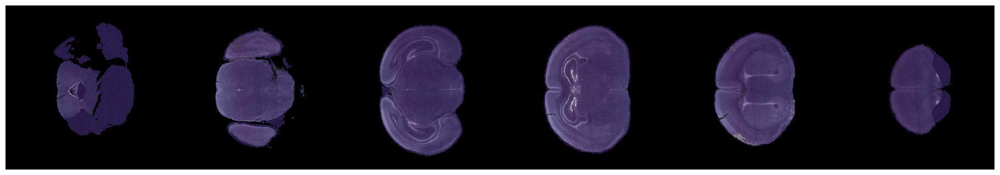

L79D769P9


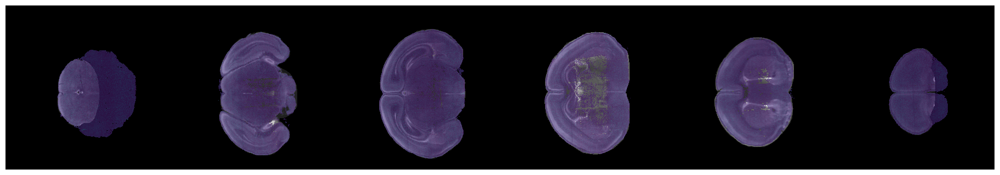

L74D769P4


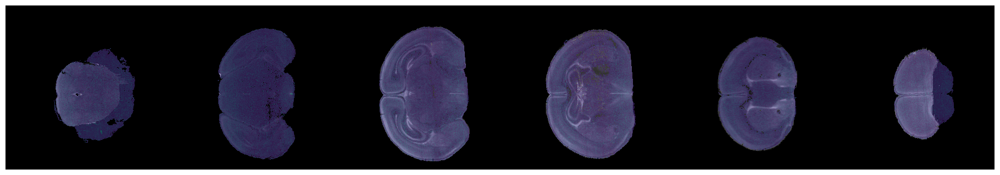

L74D769P8


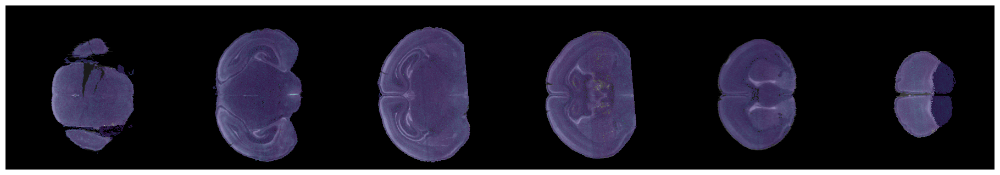

L73D766P4


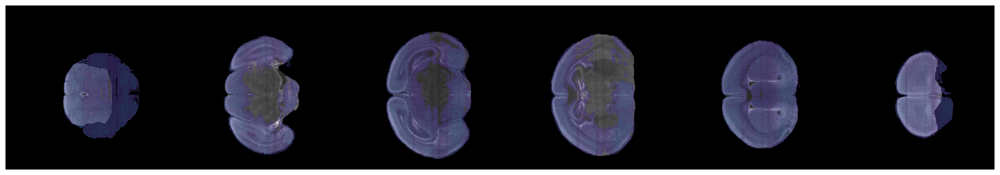

L91D814P3


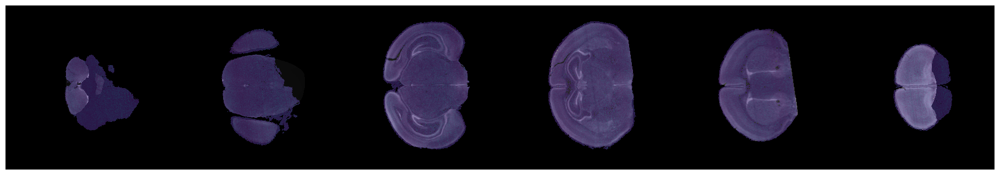

L91D814P6


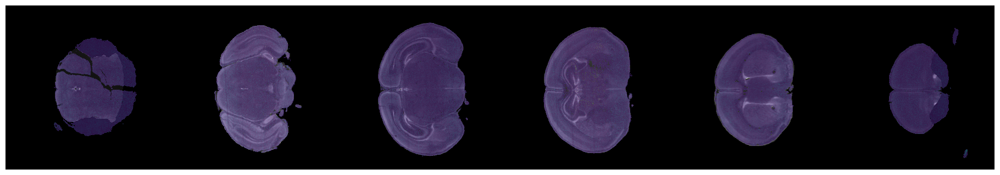

L64D804P6


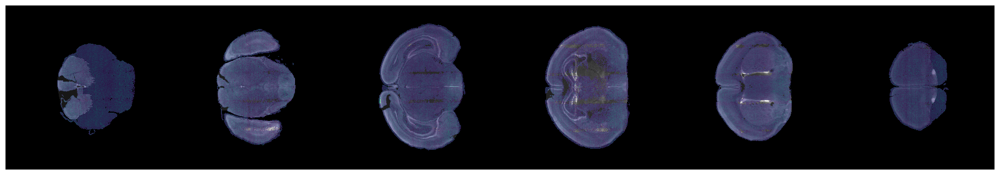

L64D804P4


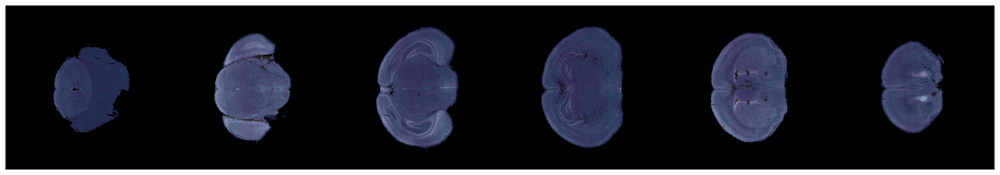

In [30]:
for sid in subject_template_origin['RotCorrectedSubjects'].keys():
    print(sid)
    density_registered_path = f'/lichtman/mdere/Felix/P4AllenAverageToLightSheet/LinearAndLandmark/Code/RegisteredVolAvgJan162024/{sid}/brainsfit_workflow/brains_fit/output_warped_image.nii'
    if subject_template_origin['RotCorrectedSubjects'][sid]['Template'] != None and os.path.isfile(density_registered_path):
        ls_masked_ants = ants.image_read(subject_template_origin['RotCorrectedSubjects'][sid]['Path'])
        density_registered_ants  = ants.image_read(density_registered_path)
        density_registered_ants.set_spacing(ls_masked_ants.spacing)
        ants.plot(ls_masked_ants, overlay = density_registered_ants, overlay_cmap = 'viridis', overlay_alpha=0.6, figsize=3, nslices=6)

In [22]:
ziquans_list = glob("/cajal/ACMUSERS/ziquanw/Lightsheet/renders/pair*/NIS_volavg_pair*_*.nii")

In [23]:
ziquans_list[:2]

['/cajal/ACMUSERS/ziquanw/Lightsheet/renders/pair9/NIS_volavg_pair9_L64D804P6.nii',
 '/cajal/ACMUSERS/ziquanw/Lightsheet/renders/pair9/NIS_volavg_pair9_L64D804P4.nii']

In [24]:
len(ziquans_list)

35

In [30]:
ziquans_sid_list = []
for each in ziquans_list:
    ziquans_sid_list.append(os.path.splitext(os.path.basename(each).split("_")[-1])[0])

In [31]:
ziquans_sid_list[:2]

['L64D804P6', 'L64D804P4']

In [25]:
hauns_five = ['L77D764P9',
'L77D764P2',
'L77D764P4',
'L57D855P6',
'L57D855P4']

In [32]:
for each in hauns_five:
    if each in ziquans_sid_list:
        print(each)

L77D764P9
L77D764P2
L77D764P4
L57D855P6
L57D855P4


In [50]:
import json
with open('subject_template_origin.json', 'w') as json_file:
    json.dump(subject_template_origin, json_file)

In [36]:
#Visualize the results using ants visualization function.

# Below this line should be used during the testing stage.

In [ ]:
# Define input file paths
fixed_image_path = '/lichtman/mdere/Felix/MOUSE/LS_P4Registered/LS/pair14/L35D719P4_C1_topro_25_300x300x300_1.nrrd'  # Replace with the path to your fixed image
moving_image_path = '/lichtman/Felix/Lightsheet/P4/pair8/output_L59D878P5/resampled/L59D878P5_C1_topro_25.nii'  # Replace with the path to your moving image
initial_transform_path = '/lichtman/mdere/Felix/MOUSE/LS_P4Registered/LS/pair8/L59D878P5_ManualTransform.mat'  # Replace with your transform file

In [ ]:
# Create a BRAINSFit node
brains_fit = Node(bf.BRAINSFit(), name='brains_fit')

# Set the fixed and moving images
brains_fit.inputs.fixedVolume = fixed_image_path
brains_fit.inputs.movingVolume = moving_image_path

# Set the initial transformation
brains_fit.inputs.initialTransform = initial_transform_path

# Specify the transformation type
brains_fit.inputs.transformType = 'Rigid'

# Set the number of iterations to zero
brains_fit.inputs.numberOfIterations = [0]

# Set interpolation to nearest neighbor
brains_fit.inputs.interpolationMode = 'NearestNeighbor'

# Additional parameters
brains_fit.inputs.outputTransform = 'output_transform.h5'
brains_fit.inputs.outputVolume = 'output_warped_image.nii'

# Create a workflow
wf = Workflow(name='brainsfit_workflow')
wf.base_dir = os.path.abspath('brainsfit_workflow_dir')  # Directory where workflow files will be stored

# Add the BRAINSFit node to the workflow
wf.add_nodes([brains_fit])

# Run the workflow
wf.run()

In [34]:
im = ants.image_read("/lichtman/mdere/Felix/P4AllenAverageToLightSheet/LinearAndLandmark/Out/Landmark/33/resampled_annot_results/L35D719P1_annotation_resampled.nrrd")

In [35]:
im.max()

1671.0